# Unsupervised Learning WS22 - Weather Stations 
## Martina Schelander

- Apply all learned methods regarding feature selection, feature extraction, dimensionality reduction
- Find any interesting information in the data (using clustering, ...)

Imports

In [2]:
# imports
import plotly.express as px                                 # used for interactive plots
import pandas as pd                                         # data handling
import numpy as np                                          # data manipulation
import seaborn as sns                                       # used for plots
import matplotlib.pyplot as plt                             # used for plots
import hdbscan                                              # HDBSCAN implementation        
from sklearn.feature_selection import VarianceThreshold     # to remove variables with low variance
from sklearn.preprocessing import OrdinalEncoder            # encoding of categorical variables 
from sklearn.preprocessing import StandardScaler            # Standard Scaler for data preprocessing
from sklearn.decomposition import PCA                       # for dimensionality reduction
from sklearn.cluster import DBSCAN                          # DBSCAN implementation
from sklearn.cluster import AgglomerativeClustering         # Agglomerative Clustering implementation
from sklearn.neighbors import NearestNeighbors              # Nearest neighhbors implementation to find eps for DBSCAN
from sklearn.cluster import KMeans                          # Kmeans implementation
from scipy.cluster.hierarchy import dendrogram, linkage     # dendrogram
from mpl_toolkits.mplot3d import Axes3D                     # Used for 3D plot
from pyod.models.lof import LOF                             # Local Outlier Filter implementation
from pyod.models.iforest import IForest                     # Isolation Forest implementation
                                                       

In [3]:
# iport csv and print head
df = pd.read_csv("./data/weather-stations.csv", delimiter=',', skiprows=0, low_memory=False)
df.head()

,Stn_Name,Lat,Long,Prov,Tm,DwTm,D,Tx,DwTx,Tn,...,DwP,P%N,S_G,Pd,BS,DwBS,BS%,HDD,CDD,Stn_No
0,CHEMAINUS,48.935,-123.742,BC,8.2,0.0,NaN,13.5,0.0,1.0,...,0.0,NaN,0.0,12.0,NaN,NaN,NaN,273.3,0.0,1011500
1,COWICHAN LAKE FORESTRY,48.824,-124.133,BC,7.0,0.0,3.0,15.0,0.0,-3.0,...,0.0,104.0,0.0,12.0,NaN,NaN,NaN,307.0,0.0,1012040
2,LAKE COWICHAN,48.829,-124.052,BC,6.8,13.0,2.8,16.0,9.0,-2.5,...,9.0,NaN,NaN,11.0,NaN,NaN,NaN,168.1,0.0,1012055
3,DISCOVERY ISLAND,48.425,-123.226,BC,NaN,NaN,NaN,12.5,0.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1012475
4,DUNCAN KELVIN CREEK,48.735,-123.728,BC,7.7,2.0,3.4,14.5,2.0,-1.0,...,2.0,NaN,NaN,11.0,NaN,NaN,NaN,267.7,0.0,1012573


Plot the stations using latitude and longitude

# 1. Missing Values Removal

In [5]:
# get basic info on the dataframe
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1341 entries, 0 to 1340
Data columns (total 25 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   Stn_Name  1341 non-null   object 
 1   Lat       1341 non-null   float64
 2   Long      1341 non-null   float64
 3   Prov      1341 non-null   object 
 4   Tm        1256 non-null   float64
 5   DwTm      1256 non-null   float64
 6   D         357 non-null    float64
 7   Tx        1260 non-null   float64
 8   DwTx      1260 non-null   float64
 9   Tn        1260 non-null   float64
 10  DwTn      1260 non-null   float64
 11  S         586 non-null    float64
 12  DwS       586 non-null    float64
 13  S%N       198 non-null    float64
 14  P         1227 non-null   float64
 15  DwP       1227 non-null   float64
 16  P%N       209 non-null    float64
 17  S_G       798 non-null    float64
 18  Pd        1227 non-null   float64
 19  BS        0 non-null      float64
 20  DwBS      0 non-null      floa

<p>We have 1341 observations, 25 columns, 3 identifying columns Stn_Name, Prov, Stn_No that are categorical and 22 numerical values (float64)
Obviously many null values. </p>

In [6]:
# Check the number of NaN per column 
df.isna().sum()

Stn_Name       0
Lat            0
Long           0
Prov           0
Tm            85
DwTm          85
D            984
Tx            81
DwTx          81
Tn            81
DwTn          81
S            755
DwS          755
S%N         1143
P            114
DwP          114
P%N         1132
S_G          543
Pd           114
BS          1341
DwBS        1341
BS%         1341
HDD           85
CDD           85
Stn_No         0
dtype: int64

### NaN Results:
<p>BS, DwBS, BS% are empty columns. The columns will be removed. We will apply the rule of thumb of dropping every column where more than half of the values (~671) are missing. In a final step we will drop rows with na values. No imputation will be applied.</p>

In [7]:
# drop column with more than half the values NaN
df_selection = df.drop(list((df.loc[:, ((df.isna().sum())>671)].columns)), axis=1)

# drop important rows with NaN
df_selection.dropna(inplace=True)

# check result
df_selection.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 715 entries, 0 to 1336
Data columns (total 17 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   Stn_Name  715 non-null    object 
 1   Lat       715 non-null    float64
 2   Long      715 non-null    float64
 3   Prov      715 non-null    object 
 4   Tm        715 non-null    float64
 5   DwTm      715 non-null    float64
 6   Tx        715 non-null    float64
 7   DwTx      715 non-null    float64
 8   Tn        715 non-null    float64
 9   DwTn      715 non-null    float64
 10  P         715 non-null    float64
 11  DwP       715 non-null    float64
 12  S_G       715 non-null    float64
 13  Pd        715 non-null    float64
 14  HDD       715 non-null    float64
 15  CDD       715 non-null    float64
 16  Stn_No    715 non-null    object 
dtypes: float64(14), object(3)
memory usage: 100.5+ KB


## NaN Removal - Results:
<p>715 entries with no NAN left. </p>

# 2. Feature Selection and Outlier Removal

## 2.1 Descriptive Statistics

In [8]:
# get descriptive statistics for the dataframe
df_selection.describe()

,Lat,Long,Tm,DwTm,Tx,DwTx,Tn,DwTn,P,DwP,S_G,Pd,HDD,CDD
count,715.000000,715.000000,715.000000,715.000000,715.000000,715.000000,715.000000,715.000000,715.000000,715.000000,715.000000,715.000000,715.000000,715.0
mean,50.812870,-96.511421,-11.837483,2.204196,2.668112,1.665734,-26.242238,1.718881,57.606014,1.531469,30.218182,8.283916,766.745455,0.0
std,5.963124,23.468102,10.361752,4.674591,8.414117,3.729493,12.830583,3.891112,66.833667,3.336842,33.283940,4.553658,307.877509,0.0
min,42.043000,-140.868000,-36.400000,0.000000,-26.700000,0.000000,-49.700000,0.000000,0.000000,0.000000,0.000000,0.000000,26.000000,0.0
25%,46.484000,-117.842000,-18.150000,0.000000,-3.400000,0.000000,-35.500000,0.000000,16.550000,0.000000,1.000000,5.000000,531.100000,0.0
50%,49.683000,-101.098000,-14.600000,0.000000,1.400000,0.000000,-29.600000,0.000000,33.000000,0.000000,24.000000,8.000000,812.200000,0.0
75%,52.938000,-73.725000,-4.700000,2.000000,9.950000,1.000000,-20.850000,1.000000,70.600000,2.000000,44.000000,12.000000,977.550000,0.0
max,82.500000,-52.753000,9.500000,27.000000,22.000000,26.000000,4.500000,25.000000,516.800000,24.000000,253.000000,22.000000,1523.400000,0.0


<p> CDD has no variance. All values are 0. It will be removed. <br> Max values for DwTm, DwTx, DwTn, P, DwP, S_G could be indicators for outlier. We will validate this later. </p>

## 2.2 Encoding of Categorical Values

In [9]:
# Encode the Province Values 
ord_enc = OrdinalEncoder()
df_selection['ProvCode'] = ord_enc.fit_transform(df_selection[['Prov']])

# remove Prov
df_selection = df_selection.drop(['Prov'], axis=1)

## 2.3 Outlier Detection

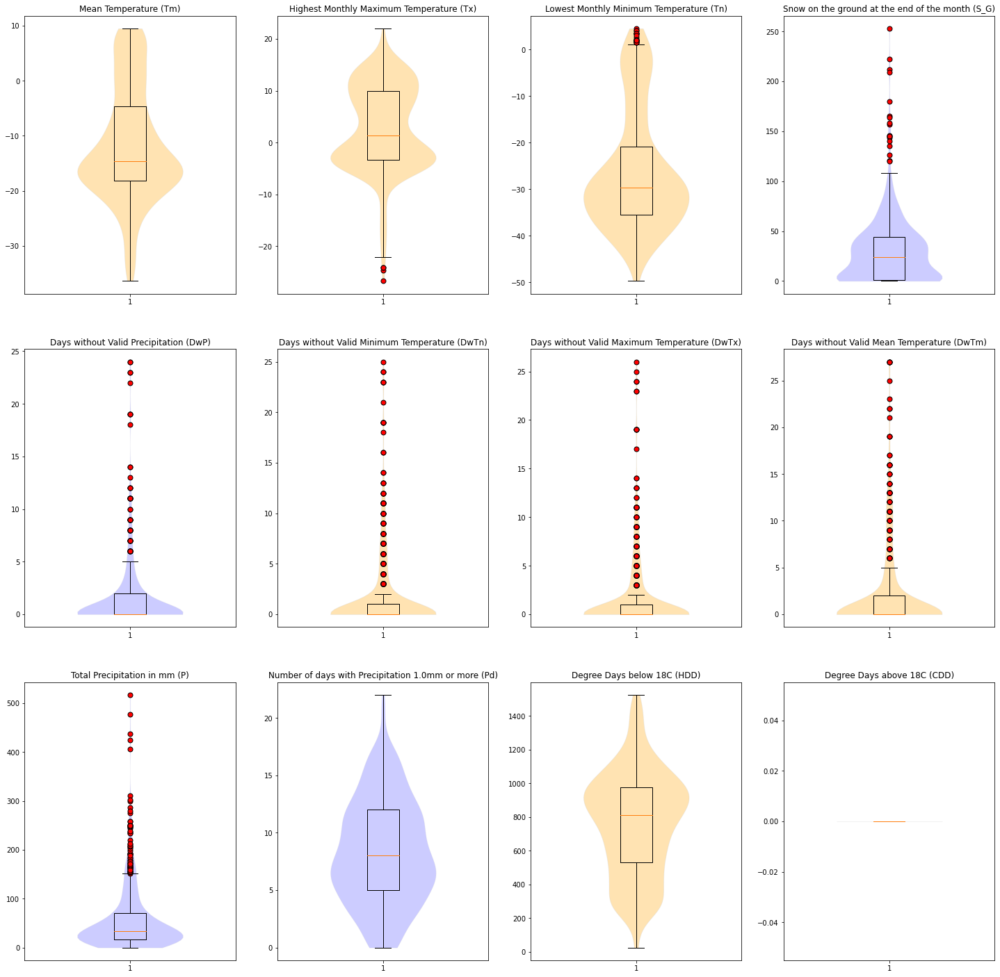

In [10]:
# Box/Violin plots to identify possible outliers and get information on the distributions
flierprops = dict(markerfacecolor='red', markersize=7)
temp=[]
perci=[]

fig, axs = plt.subplots(3, 4, figsize=(25, 25))
axs[0, 0].boxplot(df_selection['Tm'], flierprops=flierprops)
temp.append(axs[0, 0].violinplot(df_selection['Tm'], showextrema=False))
axs[0, 0].set_title('Mean Temperature (Tm)')
axs[0, 1].boxplot(df_selection['Tx'], flierprops=flierprops)
temp.append(axs[0, 1].violinplot(df_selection['Tx'], showextrema=False))
axs[0, 1].set_title('Highest Monthly Maximum Temperature (Tx)')
axs[0, 2].boxplot(df_selection['Tn'], flierprops=flierprops)
temp.append(axs[0, 2].violinplot(df_selection['Tn'], showextrema=False))
axs[0, 2].set_title('Lowest Monthly Minimum Temperature (Tn)')
axs[0, 3].boxplot(df_selection['S_G'], flierprops=flierprops)
perci.append(axs[0, 3].violinplot(df_selection['S_G'], showextrema=False))
axs[0, 3].set_title('Snow on the ground at the end of the month (S_G)')
axs[1, 0].boxplot(df_selection['DwP'], flierprops=flierprops)
perci.append(axs[1, 0].violinplot(df_selection['DwP'], showextrema=False))
axs[1, 0].set_title('Days without Valid Precipitation (DwP)')
axs[1, 1].boxplot(df_selection['DwTn'],flierprops=flierprops)
temp.append(axs[1, 1].violinplot(df_selection['DwTn'], showextrema=False))
axs[1, 1].set_title('Days without Valid Minimum Temperature (DwTn)')
axs[1, 2].boxplot(df_selection['DwTx'], flierprops=flierprops)
temp.append(axs[1, 2].violinplot(df_selection['DwTx'], showextrema=False))
axs[1, 2].set_title('Days without Valid Maximum Temperature (DwTx)')
axs[1, 3].boxplot(df_selection['DwTm'], flierprops=flierprops)
temp.append(axs[1, 3].violinplot(df_selection['DwTm'], showextrema=False))
axs[1, 3].set_title('Days without Valid Mean Temperature (DwTm)')
axs[2, 0].boxplot(df_selection['P'], flierprops=flierprops)
perci.append(axs[2, 0].violinplot(df_selection['P'], showextrema=False))
axs[2, 0].set_title('Total Precipitation in mm (P)')
axs[2, 1].boxplot(df_selection['Pd'], flierprops=flierprops)
perci.append(axs[2, 1].violinplot(df_selection['Pd'], showextrema=False))
axs[2, 1].set_title('Number of days with Precipitation 1.0mm or more (Pd)')
axs[2, 2].boxplot(df_selection['HDD'], flierprops=flierprops)
axs[2, 2].set_title('Degree Days below 18C (HDD)')
temp.append(axs[2, 2].violinplot(df_selection['HDD'], showextrema=False))
axs[2, 3].boxplot(df_selection['CDD'], flierprops=flierprops)
axs[2, 3].set_title('Degree Days above 18C (CDD)')
temp.append(axs[2, 3].violinplot(df_selection['CDD'], showextrema=False))

for violin_parts in temp:
    for pc in violin_parts['bodies']:
        pc.set_facecolor('orange')
        pc.set_alpha(0.3)
        pc.set_edgecolors('lightgrey')

for violin_parts in perci:
    for pc in violin_parts['bodies']:
        pc.set_facecolor('blue')
        pc.set_alpha(0.2)
        pc.set_edgecolors('lightgrey')

<p> We will not remove DwTx, DwTn, DwTm, DwP. The values are not measured but counted and I believe those are just extreme but valid observations. </p>
<p> The distribution and the small amount out outliers in the highest monthly maximum temperature (Tx) suggests that the marked outiers are actual outliers/wrong measurements. </p>

In [11]:
# Returs fitler for IQR outlier removal 
def calc_IQR_filter(column, df):
    """ returns an IQR filter using 1.5*IQR
    :param column: column to calc the whisker length for 
    :param df: dataframe containing the @column"""
    
    q1 = df[column].quantile(0.25)
    q3 = df[column].quantile(0.75)
    iqr = q3 - q1
         
    return ((df[column] >= q1 - 1.5 * iqr) & (df[column] <= q3 + 1.5 * iqr))

In [12]:
# Remove outlier in Tx using IQR 
df_selection = df_selection.loc[calc_IQR_filter('Tx', df_selection)]

<p>We need a different approach for 'Total Precipitation in mm (P)', 'Snow on the ground at the end of the month (S_G)' and 'Lowest Monthly Minimum Temperature (Tn)'.</p> 
<p>TN: Tn's distribution plot display a large amount of dense outliers in the upper range. These might be valid measurements and no outliers. <p>
<p>P, S_G: The whisker length of 1.5*IQR seems to be a bad choice for S_G and P. There is a dense cluster of measurements outside of that range that might be valid. The visulization of the geographic position to the values give an insight on that. </p>

In [13]:
# Caclulate the P values outside 1.5*IQR and display them on the map
df_outlier_p = df_selection.loc[~calc_IQR_filter('P', df_selection)]
fig = px.scatter_geo(df_outlier_p, scope='north america', lat='Lat',lon='Long', hover_name='Stn_Name', opacity=0.7, width=600, height=400)
fig.update_layout(title = 'Possible Outliers "P"', title_x=0.5)
fig.show("notebook")

#### Assumption: When a number of weather stations in close proximity to each other report equally high values, these values are not outliers but valid extrem weather observations in the respective area. I will keep these values in the dataset. The high precipitation values in British Columbia (Westcoast), Neufoundland and Nova Scotia (East Coast) are real!


In [14]:
# Caclulate the Tn values outside 1.5*IQR and display them on the map
df_outlier_Tn = df_selection.loc[~calc_IQR_filter('Tn', df_selection)]
fig = px.scatter_geo(df_outlier_Tn, scope='north america', lat='Lat',lon='Long', hover_name='Stn_Name', opacity=0.7, width=600, height=400)
fig.update_layout(title = 'Possible Outliers "Tn"', title_x=0.5)

#### The lowest monthly minimal temperatures in British Columbia seem to be valid, since they are reported by many weather stations in high proximity to each other. I will keep them in the dataset. 

In [15]:
# Caclulate the S_G values outside 1.5*IQR and display them on the map
df_outlier_S_G = df_selection.loc[~calc_IQR_filter('S_G', df_selection)]
fig = px.scatter_geo(df_outlier_S_G, scope='north america', lat='Lat',lon='Long', hover_name='Stn_Name', opacity=0.7, width=600, height=400)
fig.update_layout(title = 'Possible Outliers "S_G"', title_x=0.5)

#### Snow on the ground values from the east coast seem valid. There might be outliers in midland and the westcoast. I will use and outlier ensemble to evaluate on a multivariate base and remove them afterwards. 

In [16]:
# Create outlier classifier ensemble using Local Outlier Factor and Isolation Forest
from sklearn.preprocessing import QuantileTransformer
df_selection_out = df_selection.loc[:, 'Tm':'HDD']

to_scale=['Tm', 'DwTm', 'Tx', 'DwTx', 'Tn', 'DwTn', 'P', 'DwP', 'S_G', 'Pd', 'HDD']
scaler = QuantileTransformer(n_quantiles=100, output_distribution='normal')
df_selection_out.loc[:, to_scale] = scaler.fit_transform(df_selection_out[to_scale]) 
estimators = [LOF(), IForest()]
shape = len(df_selection_out), len(estimators)
probability_scores = np.empty(shape=shape)

for index, esti in enumerate(estimators):
    esti.fit(df_selection_out)
    probs = esti.predict_proba(df_selection_out)
    probability_scores[:, index] = probs[:, 1]

median_scores = np.median(probability_scores, axis=1)
is_outlier = median_scores > 0.70   # define outliers with probability score of 75%
outliers = df_selection_out[is_outlier] # remove outliers
print(outliers) 
df_selection = df_selection[~is_outlier] # keep everything but the outliers

           Tm      DwTm        Tx      DwTx        Tn      DwTn         P  \
41   1.578381  0.559592  1.366707  0.604585  1.564726 -5.199338  2.326469   
408 -0.731217  5.199338  0.269066  2.760460  0.430727  2.932080 -5.199338   

          DwP       S_G        Pd       HDD  
41  -5.199338 -5.199338  1.366707 -1.435682  
408  1.955661 -5.199338 -5.199338 -3.200929  


C:\Winpython\python-3.9.5.amd64\lib\site-packages\sklearn\base.py:443: UserWarning:

X has feature names, but IsolationForest was fitted without feature names



## 2.4 Feature Selection using Variance 

In [17]:
# remove CDD because it has no variance at all
df_selection = df_selection.drop('CDD', axis=1)

# remove columns with variance below threshold
selector = VarianceThreshold(threshold=0.005)
selector.fit(df_selection/df_selection.mean())
mask = selector.get_support()
reduced_df = df_selection.loc[:, mask]
print(reduced_df.shape)
print(df_selection.shape)

(709, 14)
(709, 16)


C:\Winpython\python-3.9.5.amd64\lib\site-packages\sklearn\feature_selection\_variance_threshold.py:104: RuntimeWarning:

Degrees of freedom <= 0 for slice.



#### S_G and Pd were removed. 

## 2.5 Remove Identifier
Remove IDs and position that will not be used for clustering

In [18]:
# remove id and position columns
df_cluster = reduced_df.drop(['Stn_Name', 'Stn_No', 'Lat', 'Long'], axis=1)

# 3 Feature extraction and dimensionality reduction

## 3.1 Check for correlated variables

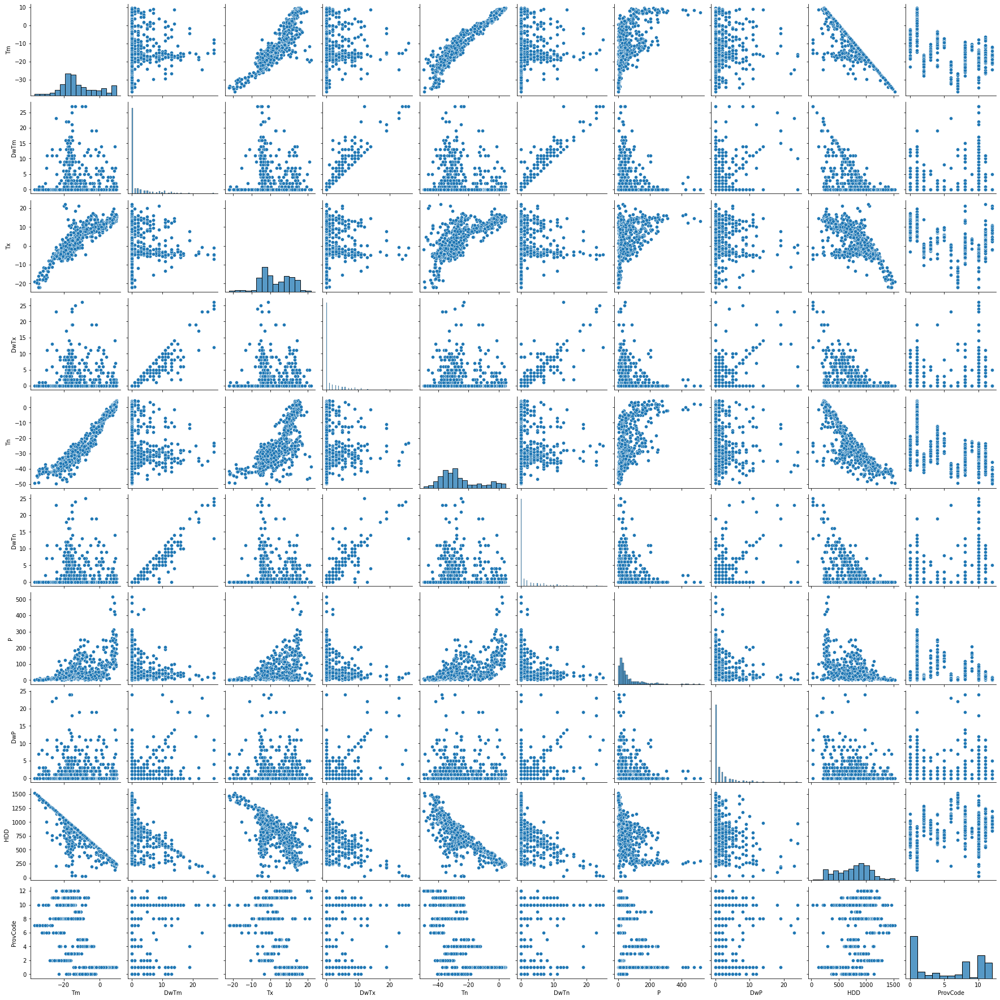

In [19]:
# Check pairplots for possible correlations between the variables
sns.pairplot(df_cluster)

In [20]:
# Check the correlation matrix for possible correlations between the variables
corr = df_cluster.corr()
corr

,Tm,DwTm,Tx,DwTx,Tn,DwTn,P,DwP,HDD,ProvCode
Tm,1.000000,-0.060411,0.872079,-0.028301,0.949313,-0.023363,0.577728,-0.016820,-0.870922,-0.637021
DwTm,-0.060411,1.000000,-0.153379,0.938000,-0.042305,0.954745,-0.097135,0.536738,-0.425429,0.193576
Tx,0.872079,-0.153379,1.000000,-0.106675,0.732105,-0.106273,0.428797,-0.048336,-0.709989,-0.608612
DwTx,-0.028301,0.938000,-0.106675,1.000000,-0.012773,0.903924,-0.085540,0.620804,-0.418315,0.128946
Tn,0.949313,-0.042305,0.732105,-0.012773,1.000000,-0.005098,0.621374,-0.011737,-0.834012,-0.625361
DwTn,-0.023363,0.954745,-0.106273,0.903924,-0.005098,1.000000,-0.086530,0.573601,-0.430058,0.134793
P,0.577728,-0.097135,0.428797,-0.085540,0.621374,-0.086530,1.000000,-0.079294,-0.481000,-0.319945
DwP,-0.016820,0.536738,-0.048336,0.620804,-0.011737,0.573601,-0.079294,1.000000,-0.222848,0.000760
HDD,-0.870922,-0.425429,-0.709989,-0.418315,-0.834012,-0.430058,-0.481000,-0.222848,1.000000,0.470891
ProvCode,-0.637021,0.193576,-0.608612,0.128946,-0.625361,0.134793,-0.319945,0.000760,0.470891,1.000000


<AxesSubplot:>

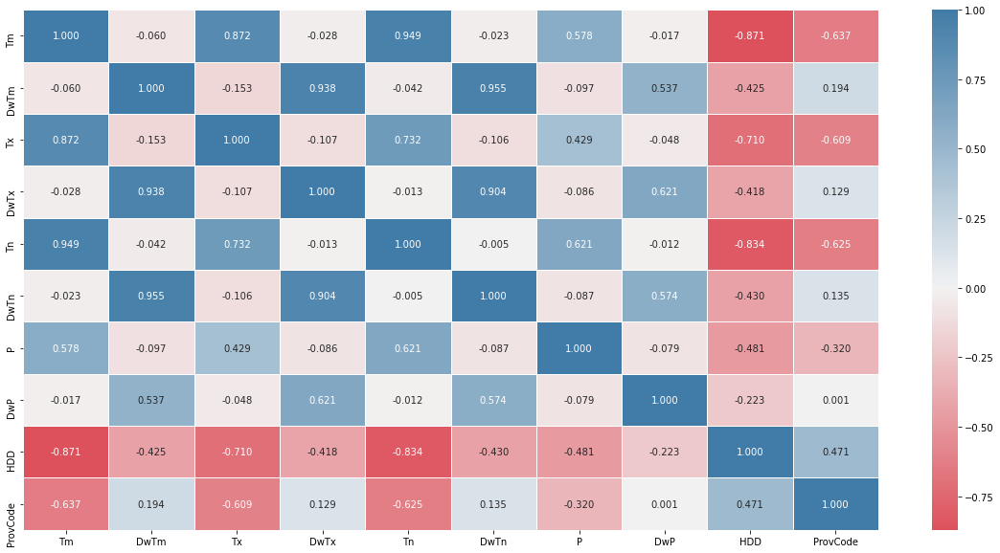

In [21]:
# Check correlation using Seaborn Heatmap, which is in this case probably the most comfortable method to get an overview
plt.figure(figsize=(20,10))
cmap = sns.diverging_palette(h_neg=10, h_pos=240, as_cmap=True)
sns.heatmap(df_cluster.corr(), center=0, cmap=cmap, linewidth=1, annot=True, fmt=".3f")

### Correlation Results 
Highly correlated variables ((abs)>0.9) are: 
- Tm ~ Tn (+)
- DwTm ~ DwTx (+)
- DwTm ~ DwTn (+)
- DwTx ~ DwTn (+)

Moderatley high correlated variables ((abs)>|0.75|) are: 
- Tm ~ Tx (+)
- Tm ~ HDD (-)
- Tn ~ HDD (-)

<p> Not surprisingly all temperature values are correlated to each other.</p>


## 3.2 Apply PCA for dimensionality reduction

As seen in the latest step many of the variables are (highly) correlated and it makes sence to apply dimensionality reduction methods to reduce the dataset's dimensionality and make the resulting model less complex. Let's reduce the number of the dimensions using principal component analysis.

No of component:  4
Amount of variance explained by the extracted components (orderd): [0.4325449  0.3525121  0.0753485  0.05893262]


Text(0.5, 0, 'Number of components')

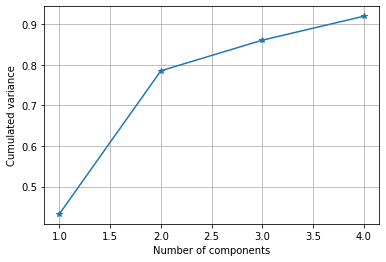

In [22]:
# Scale the data
scaler = StandardScaler()
df_scaled = scaler.fit_transform(df_cluster) 

# create pca model that keeps 90% of the dataset's variance
pca = PCA(0.90).fit(df_scaled)  # keep 90% variance
print(f"No of component: ", pca.n_components_) # get number of components 

# put the resulting pca scores for the dataset in a new df
df_components = pca.transform(df_scaled)

# print the ordered amount of variance explained by each component
print(f"Amount of variance explained by the extracted components (orderd):",pca.explained_variance_ratio_)

# plot for cumulated variance 
plt.plot(range(1,5), pca.explained_variance_ratio_.cumsum(), marker = '*')
plt.grid()
plt.ylabel('Cumulated variance')
plt.xlabel('Number of components')

# 4 Clustering Approaches

## 4.1 Kmeans

### Decide on a reasonable number of clusters using an elbow plot

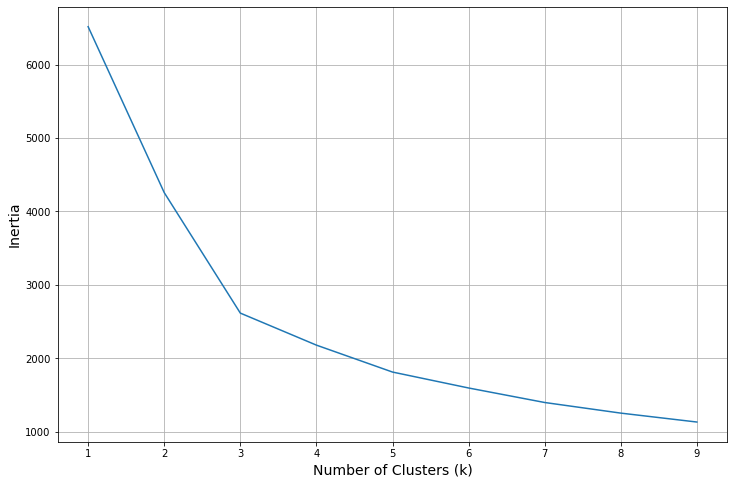

In [23]:
# Initialize model 
# List of result values for every k in range(1,15)
results = []

for i in range(1,10):
    kmeans = KMeans(
        n_clusters=i,                   # set the number of clusters     
        verbose=0,                      # output verbosity level (2 ... output inertia)
        random_state=42                 # reproduction parameters
    )
    kmeans.fit_predict(pd.DataFrame(df_components))
    results.append(kmeans.inertia_)

plt.figure(figsize=(12,8))    
plt.plot(range(1,10), results[:])
plt.xlabel("Number of Clusters (k)", fontdict={'size':14})
plt.ylabel("Inertia", fontdict={'size':14})
plt.grid()
plt.show()

In [24]:
# According to the elbow plot 3, 5, 7 are possible choices for k
# perform kMeans clustering with k = 5
kmeans = KMeans(
    n_clusters=3,                   # set the number of clusters     
    verbose=0,                      # output verbosity level (2 ... output inertia)
    random_state=42                 # reproduction parameters
)
kmeans.fit_predict(df_components)

array([2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 0, 2, 0, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2,
       0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 1, 1, 1, 1, 2, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 1, 2, 1, 0, 1, 1, 1, 2, 2, 2, 1, 2,
       0, 1, 0, 1, 2, 1, 2, 0, 1, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 0, 2, 2, 0, 1, 2, 1, 1, 1,
       1, 2, 2, 1, 1, 2, 1, 1, 0, 2, 1, 1, 1, 1, 0,

In [25]:
# add KMeans cluster labels to result data frame
df_results = pd.concat([df_cluster.reset_index(drop=True), pd.DataFrame(df_components)], axis = 1) #df.reset_index(drop=True)
df_results.columns.values[-4:] = ['c1', 'c2', 'c3', 'c4']
df_results['KMeans'] = kmeans.labels_
print(df_results)

       Tm  DwTm    Tx  DwTx    Tn  DwTn      P  DwP     HDD  ProvCode  \
0     8.2   0.0  13.5   0.0   1.0   0.0  178.8  0.0   273.3       1.0   
1     7.0   0.0  15.0   0.0  -3.0   0.0  258.6  0.0   307.0       1.0   
2     8.9   7.0  13.5   7.0   2.0   7.0  110.0  7.0   191.7       1.0   
3     7.7   0.0  14.7   0.0  -2.6   0.0  132.8  0.0   288.8       1.0   
4     8.6   1.0  14.0   1.0   2.0   1.0   91.1  1.0   253.6       1.0   
..    ...   ...   ...   ...   ...   ...    ...  ...     ...       ...   
704  -7.2   0.0   8.7   0.0 -20.0   0.0  144.6  0.0   706.3       4.0   
705 -19.2   2.0   2.0   2.0 -29.9   1.0  122.6  2.0   968.0       4.0   
706 -22.0   0.0  -4.2   0.0 -36.3   0.0   90.2  0.0  1119.3       4.0   
707 -22.7   0.0  -6.5   0.0 -33.4   0.0   35.6  0.0  1140.5       4.0   
708 -22.6   0.0  -6.8   0.0 -33.5   0.0   46.6  0.0  1136.5       4.0   

           c1        c2        c3        c4  KMeans  
0    4.005847 -1.105573  0.735275  0.199016       2  
1    4.212164 -

## 4.2 DBSCAN

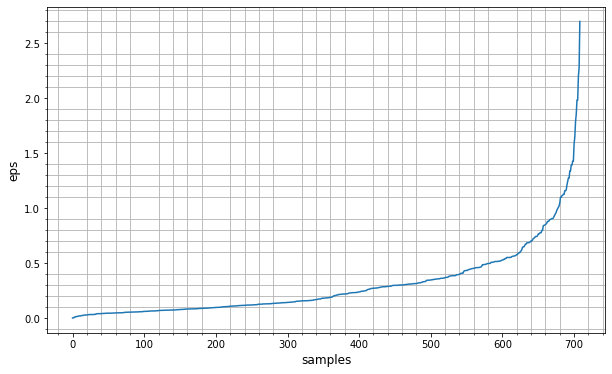

In [26]:
# find eps
nn_model = NearestNeighbors(n_neighbors=2)
neighbors = nn_model.fit(df_components)
distances, indices = neighbors.kneighbors(df_components)
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.figure(figsize=(10,6))
plt.ylabel('eps',fontdict={'size':12})
plt.xlabel('samples',fontdict={'size':12})
plt.plot(distances)
plt.grid(which = "minor")
plt.minorticks_on()
plt.show()

In [27]:
# perform DBSCAN eps=1, min_samples=8
dbscan_labels = DBSCAN(eps=1, min_samples=8).fit_predict(df_components)
df_results['DBSCAN'] = dbscan_labels
print(f"Number of clusters found by DBSCAN: {len(df_results['DBSCAN'].unique())-1}")

Number of clusters found by DBSCAN: 2


## 4.3 HDBSCAN

In [28]:
# perform DBSCAN min_cluster_size=10
hdbscan_labels = hdbscan.HDBSCAN(min_cluster_size=10).fit_predict(df_components)
df_results['HDBSCAN'] = hdbscan_labels
print(f"Number of clusters found by HDBSCAN: {len(df_results['HDBSCAN'].unique())-1}")

Number of clusters found by HDBSCAN: 5


## 4.4 Hierachical clustering

Text(0.0, 41, ' 3 Clusters')

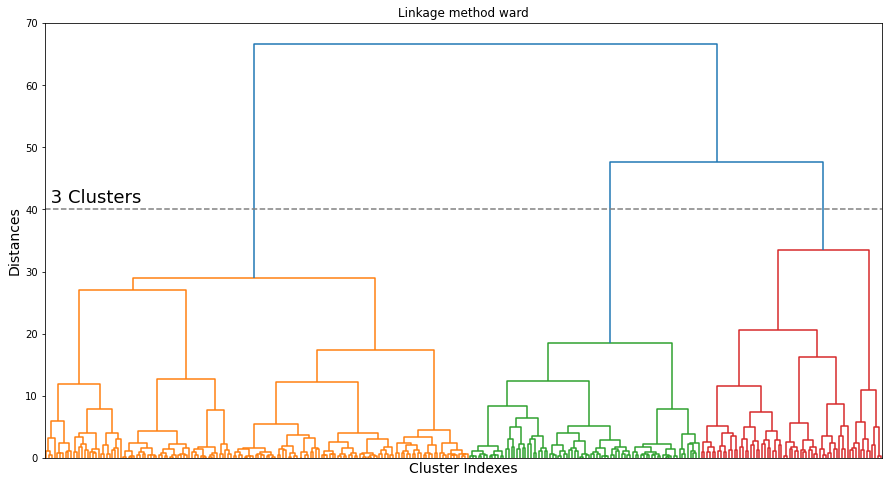

In [29]:
linkage_array = linkage(df_components, method='ward', metric='euclidean', optimal_ordering=True)

plt.figure(figsize=(15,8))
dendrogram(linkage_array, p=8, truncate_mode='level', no_labels = True)
plt.title('Linkage method ward')
plt.ylabel('Distances',fontdict={'size':14})
plt.xlabel('Cluster Indexes',fontdict={'size':14})
axes = plt.gca()
xbound = axes.get_xbound()
axes.plot(xbound, [40, 40], '--', color='grey')
axes.text(xbound[0], 41, ' 3 Clusters', fontdict={'size':18})

In [30]:
agg = AgglomerativeClustering(n_clusters = 3, linkage = 'ward')
pred_labels_agg = agg.fit_predict(df_components)
df_results['AGG'] = pred_labels_agg

# 5 Clustering Evaluation 

### Let's visualize the first 3 components as they describe 86% of the dataset's variance 

In [31]:
# results dataframe including cluster labels, position and ID columns
df_clustering_results = pd.concat([df_selection, df_results.set_index(df_selection.index)], axis=1)
print(df_clustering_results)

                    Stn_Name     Lat     Long    Tm  DwTm    Tx  DwTx    Tn  \
0                  CHEMAINUS  48.935 -123.742   8.2   0.0  13.5   0.0   1.0   
1     COWICHAN LAKE FORESTRY  48.824 -124.133   7.0   0.0  15.0   0.0  -3.0   
6              GALIANO NORTH  48.985 -123.573   8.9   7.0  13.5   7.0   2.0   
10            NORTH COWICHAN  48.824 -123.719   7.7   0.0  14.7   0.0  -2.6   
11       NORTH PENDER ISLAND  48.764 -123.287   8.6   1.0  14.0   1.0   2.0   
...                      ...     ...      ...   ...   ...   ...   ...   ...   
1324              WRECKHOUSE  47.712  -59.308  -7.2   0.0   8.7   0.0 -20.0   
1330              CARTWRIGHT  53.708  -57.035 -19.2   2.0   2.0   2.0 -29.9   
1332                 GOOSE A  53.317  -60.417 -22.0   0.0  -4.2   0.0 -36.3   
1335                    NAIN  56.550  -61.683 -22.7   0.0  -6.5   0.0 -33.4   
1336                  NAIN A  56.550  -61.683 -22.6   0.0  -6.8   0.0 -33.5   

      DwTn      P  ...     HDD  ProvCode        c1 

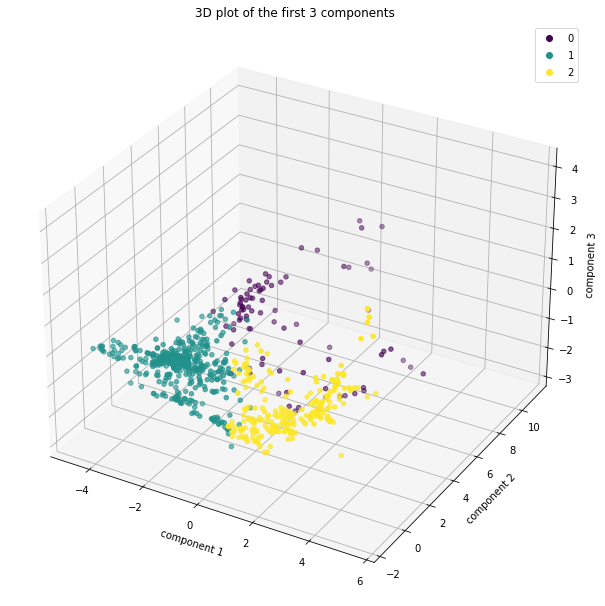

In [32]:
# KMEANS results of the first 3 components
fig = plt.figure(figsize=(12,8))
ax = Axes3D(fig, auto_add_to_figure=False)
fig.add_axes(ax)

sc = ax.scatter(df_results['c1'], df_results['c2'], df_results['c3'],c=df_results['KMeans'], cmap='viridis')
ax.set_title("3D plot of the first 3 components")
ax.set_xlabel('component 1')
ax.set_ylabel('component 2')
ax.set_zlabel('component 3')
plt.legend(*sc.legend_elements())
  
plt.show()

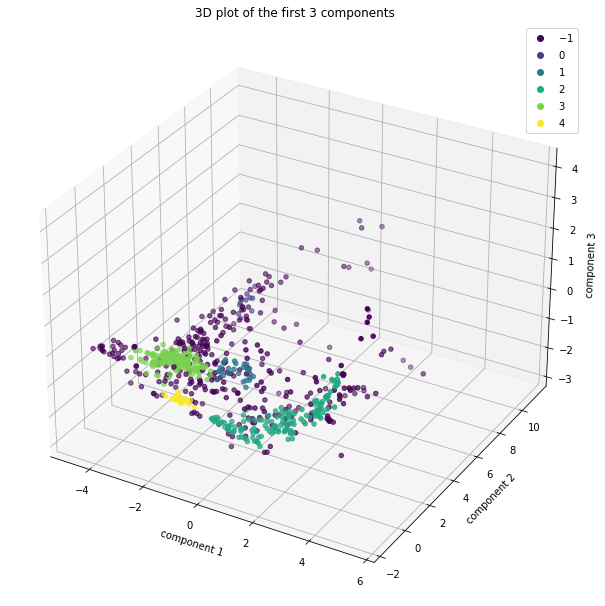

In [33]:
# HDBSCAN results of the first 3 components
fig = plt.figure(figsize=(12,8))
ax = Axes3D(fig, auto_add_to_figure=False)
fig.add_axes(ax)

sc = ax.scatter(df_results['c1'], df_results['c2'], df_results['c3'],c=df_results['HDBSCAN'], cmap='viridis')
ax.set_title("3D plot of the first 3 components")
ax.set_xlabel('component 1')
ax.set_ylabel('component 2')
ax.set_zlabel('component 3')
plt.legend(*sc.legend_elements())
  
plt.show()

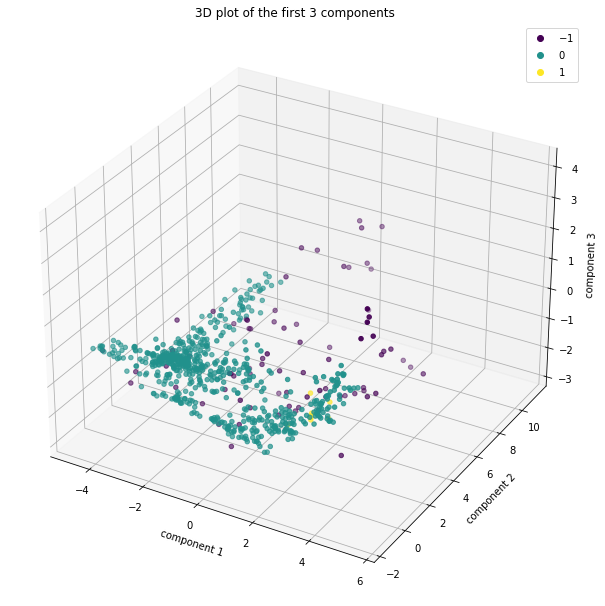

In [34]:
# DBSCAN results of the first three components
fig = plt.figure(figsize=(12,8))
ax = Axes3D(fig, auto_add_to_figure=False)
fig.add_axes(ax)

sc = ax.scatter(df_results['c1'], df_results['c2'], df_results['c3'],c=df_results['DBSCAN'], cmap='viridis')
ax.set_title("3D plot of the first 3 components")
ax.set_xlabel('component 1')
ax.set_ylabel('component 2')
ax.set_zlabel('component 3')
plt.legend(*sc.legend_elements())
  
plt.show()

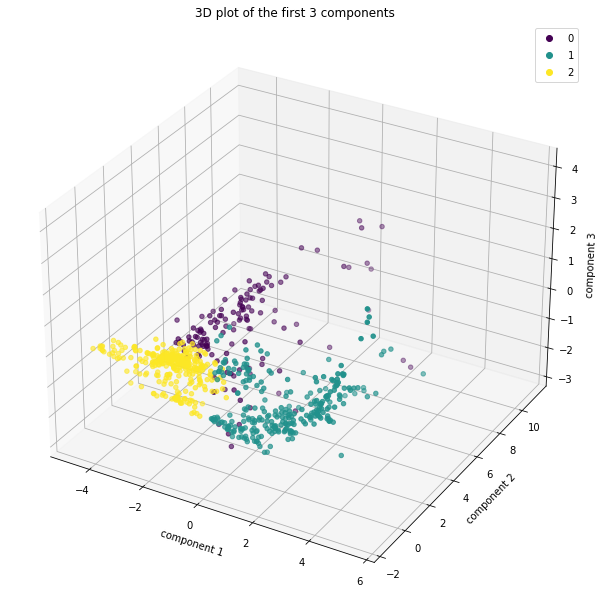

In [35]:
# Agglomerative clustering results of the first 3 components
fig = plt.figure(figsize=(12,8))
ax = Axes3D(fig, auto_add_to_figure=False)
fig.add_axes(ax)

sc = ax.scatter(df_results['c1'], df_results['c2'], df_results['c3'],c=df_results['AGG'], cmap='viridis')
ax.set_title("3D plot of the first 3 components")
ax.set_xlabel('component 1')
ax.set_ylabel('component 2')
ax.set_zlabel('component 3')
plt.legend(*sc.legend_elements())
  
plt.show()

# 6 Final Results and Discussion


In [37]:
# color according to Agglomerative Clustering results
df_clustering_results["AGG_cat"] = df_clustering_results["AGG"].astype(str)
fig = px.scatter_geo(df_clustering_results, color='AGG_cat', scope='north america', lat='Lat',lon='Long', hover_name='Stn_Name', opacity=0.7, width=800, height=600)
fig.update_layout(title = 'Agglomerative Clusters', title_x=0.5)
fig.show("notebook")

In [38]:
# color according to HDBSCAN clusters
df_clustering_results["HDBSCAN_cat"] = df_clustering_results["HDBSCAN"].astype(str)
colors = ['#1e90ff','#ff8c00','#2e8b57']

fig = px.scatter_geo(df_clustering_results, color='HDBSCAN_cat', scope='north america', color_discrete_map={"-1": 'lightgrey', "0":'blue', "1":'orange', "2":'green', "3":'crimson', "4":'purple'}, lat='Lat',lon='Long', hover_name='Stn_Name', opacity=0.7, width=800, height=500)
fig.update_layout(title = 'HDBSCAN Cluster', title_x=0.5)
fig.show("notebook")

## 6.1 Visual Results based on GPS Coordinates

#### The results of KMeans and Agglomerative Clustering indicate that the weather on the coastal areas is different from the weather on midland. Kmeans clearly identifies a cluster in the southwest covering British-Columbia and Alberta and another cluster on the eastcoast. Both algorithms identified a cluster in the urban area of Quebec.
#### HDBSCAN identifies 5 distincs clusters. One on the westcoast covering the area of British-Columbia and Alberta. A second cluster covering the east coast including Newfoundland and nova scotia. A third one in midland in the provice of Manitoba. One in the bayarea of Quebec and a general cluser covering midland areas including Ontario, Saskatchewan, The northern Territories and Yukon.</p>

## 6.2 Meteorological characteristics of the clusters

#### I will have a look at what conditions are prevalent in the identified clusters using the HDBSCAN clustering result. 

### 6.2.1 Average Temperatures

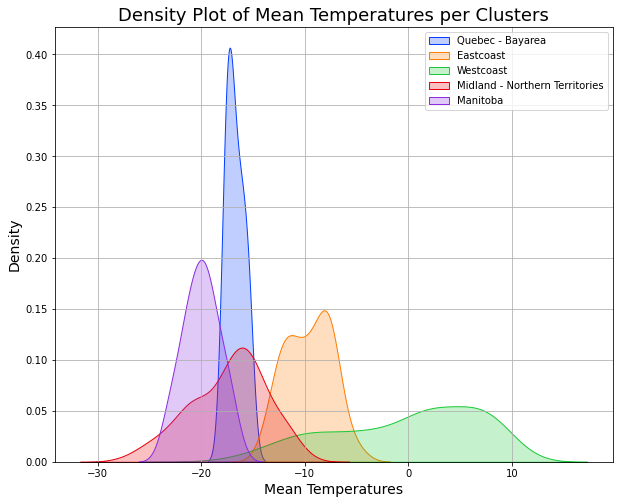

In [39]:
fig = plt.figure(figsize=(10,8))
sns.set_palette("bright")
sns.kdeplot(x=df_results.query('HDBSCAN == 0')['Tm'], shade=True, label='Quebec - Bayarea')
sns.kdeplot(x=df_results.query('HDBSCAN == 1')['Tm'], shade=True, label='Eastcoast')
sns.kdeplot(x=df_results.query('HDBSCAN == 2')['Tm'], shade=True, label='Westcoast')
sns.kdeplot(x=df_results.query('HDBSCAN == 3')['Tm'], shade=True, label='Midland - Northern Territories')
sns.kdeplot(x=df_results.query('HDBSCAN == 4')['Tm'], shade=True, label='Manitoba')
plt.ylabel("Density", fontsize=14, color='black')
plt.xlabel("Mean Temperatures", fontsize=14, color='black')
plt.title("Density Plot of Mean Temperatures per Clusters", fontsize=18)
plt.legend()
plt.grid()
plt.show()

### 6.2.2 Highest monthly Maximum Temperature

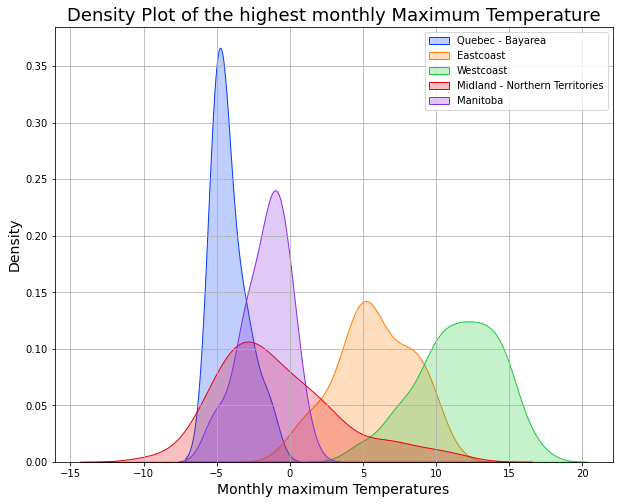

In [40]:
fig = plt.figure(figsize=(10,8))
sns.set_palette("bright")
sns.kdeplot(x=df_results.query('HDBSCAN == 0')['Tx'], shade=True, label='Quebec - Bayarea')
sns.kdeplot(x=df_results.query('HDBSCAN == 1')['Tx'], shade=True, label='Eastcoast')
sns.kdeplot(x=df_results.query('HDBSCAN == 2')['Tx'], shade=True, label='Westcoast')
sns.kdeplot(x=df_results.query('HDBSCAN == 3')['Tx'], shade=True, label='Midland - Northern Territories')
sns.kdeplot(x=df_results.query('HDBSCAN == 4')['Tx'], shade=True, label='Manitoba')
plt.ylabel("Density", fontsize=14, color='black')
plt.xlabel("Monthly maximum Temperatures", fontsize=14, color='black')
plt.title("Density Plot of the highest monthly Maximum Temperature", fontsize=18)
plt.legend()
plt.grid()
plt.show()

### 6.2.3 Lowest monthly Minimum Temperatures

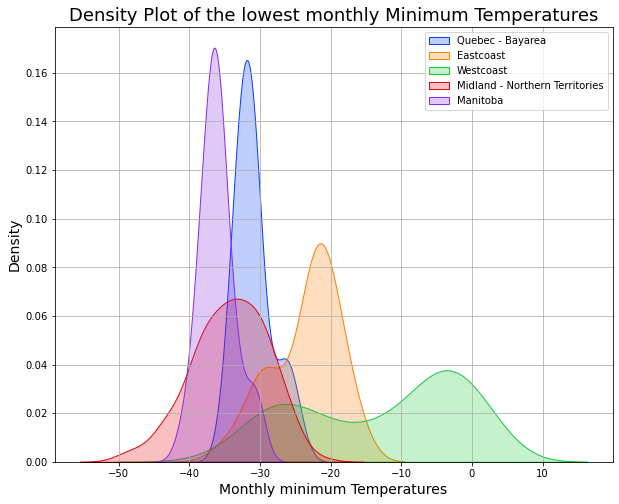

In [41]:
fig = plt.figure(figsize=(10,8))
sns.set_palette("bright")
sns.kdeplot(x=df_results.query('HDBSCAN == 0')['Tn'], shade=True, label='Quebec - Bayarea')
sns.kdeplot(x=df_results.query('HDBSCAN == 1')['Tn'], shade=True, label='Eastcoast')
sns.kdeplot(x=df_results.query('HDBSCAN == 2')['Tn'], shade=True, label='Westcoast')
sns.kdeplot(x=df_results.query('HDBSCAN == 3')['Tn'], shade=True, label='Midland - Northern Territories')
sns.kdeplot(x=df_results.query('HDBSCAN == 4')['Tn'], shade=True, label='Manitoba')
plt.ylabel("Density", fontsize=14, color='black')
plt.xlabel("Monthly minimum Temperatures", fontsize=14, color='black')
plt.title("Density Plot of the lowest monthly Minimum Temperatures", fontsize=18)
plt.legend()
plt.grid()
plt.show()

###  6.2.4 Precipitation

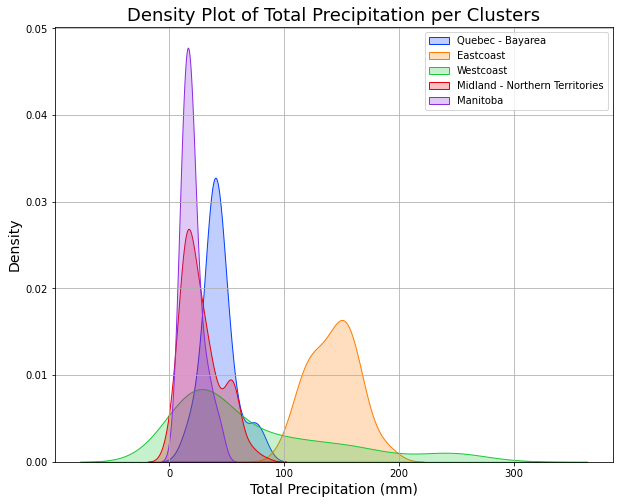

In [186]:
fig = plt.figure(figsize=(10,8))
sns.kdeplot(x=df_results.query('HDBSCAN == 0')['P'], shade=True, label='Quebec - Bayarea')
sns.kdeplot(x=df_results.query('HDBSCAN == 1')['P'], shade=True, label='Eastcoast')
sns.kdeplot(x=df_results.query('HDBSCAN == 2')['P'], shade=True, label='Westcoast')
sns.kdeplot(x=df_results.query('HDBSCAN == 3')['P'], shade=True, label='Midland - Northern Territories')
sns.kdeplot(x=df_results.query('HDBSCAN == 4')['P'], shade=True, label='Manitoba')
plt.ylabel("Density", fontsize=14, color='black')
plt.xlabel("Total Precipitation (mm)", fontsize=14, color='black')
plt.title("Density Plot of Total Precipitation per Clusters", fontsize=18)
plt.legend()
plt.grid()
plt.show()

## Results

- Mean, maximum and minimum temperatures on the westcoast and eastcoast are generally higher compared to midland areas of canada. They also show a higher variability. 

- The highest mean, maximum and minimum temperatures are observed on the westcoast, making it canada's warmest area. 

- The spatial area of the cluster covering Quebec is small and as a result the variability in the mean temperatures is small. Temperatures are low compared to the other clusters except Manitoba.

- The cluster with the lowest mean and lowest monthly minimum temperatures is Manitoba.

- The highest precipitation amounts are observed on the the east coast. The Midlands and MAnitoba are the driest areas. 

- The percipitation amounts on the westcoast show a high variability, covering the areas with the highest amount of rainfall but also same of the driest spots. 